<h1>Table of Contents<span class="tocSkip"></span></h1>
<div class="toc"><ul class="toc-item"><li><span><a href="#Generating-a-Second-Order-Autoregressive-Process" data-toc-modified-id="Generating-a-Second-Order-Autoregressive-Process-1"><span class="toc-item-num">1&nbsp;&nbsp;</span>Generating a Second Order Autoregressive Process</a></span></li><li><span><a href="#Generating-a-Time-varying-AR-process" data-toc-modified-id="Generating-a-Time-varying-AR-process-2"><span class="toc-item-num">2&nbsp;&nbsp;</span>Generating a Time-varying AR process</a></span></li><li><span><a href="#Kalman-Filter-Estimates-of-second-order-AR-parameters" data-toc-modified-id="Kalman-Filter-Estimates-of-second-order-AR-parameters-3"><span class="toc-item-num">3&nbsp;&nbsp;</span>Kalman Filter Estimates of second order AR parameters</a></span></li><li><span><a href="#Partile-Filter-Estimates-of-second-order-AR-parameters" data-toc-modified-id="Partile-Filter-Estimates-of-second-order-AR-parameters-4"><span class="toc-item-num">4&nbsp;&nbsp;</span>Partile Filter Estimates of second order AR parameters</a></span><ul class="toc-item"><li><span><a href="#A-distribution-of-random-particles-in-2D" data-toc-modified-id="A-distribution-of-random-particles-in-2D-4.1"><span class="toc-item-num">4.1&nbsp;&nbsp;</span>A distribution of random particles in 2D</a></span></li><li><span><a href="#Algorithm-1:-Sequential-Monte-Carlo" data-toc-modified-id="Algorithm-1:-Sequential-Monte-Carlo-4.2"><span class="toc-item-num">4.2&nbsp;&nbsp;</span>Algorithm 1: Sequential Monte Carlo</a></span></li><li><span><a href="#Algorithm-2:-Particle-Filter-with-Resampling" data-toc-modified-id="Algorithm-2:-Particle-Filter-with-Resampling-4.3"><span class="toc-item-num">4.3&nbsp;&nbsp;</span>Algorithm 2: Particle Filter with Resampling</a></span></li></ul></li><li><span><a href="#Generating-Data-for-Logistic-Regression-Classifier" data-toc-modified-id="Generating-Data-for-Logistic-Regression-Classifier-5"><span class="toc-item-num">5&nbsp;&nbsp;</span>Generating Data for Logistic Regression Classifier</a></span></li><li><span><a href="#Online-PCA" data-toc-modified-id="Online-PCA-6"><span class="toc-item-num">6&nbsp;&nbsp;</span>Online PCA</a></span><ul class="toc-item"><li><span><a href="#Full-Dataset" data-toc-modified-id="Full-Dataset-6.1"><span class="toc-item-num">6.1&nbsp;&nbsp;</span>Full Dataset</a></span><ul class="toc-item"><li><span><a href="#Kalman-Filter" data-toc-modified-id="Kalman-Filter-6.1.1"><span class="toc-item-num">6.1.1&nbsp;&nbsp;</span>Kalman Filter</a></span></li><li><span><a href="#Sklearn" data-toc-modified-id="Sklearn-6.1.2"><span class="toc-item-num">6.1.2&nbsp;&nbsp;</span>Sklearn</a></span></li></ul></li><li><span><a href="#PCA-Dataset" data-toc-modified-id="PCA-Dataset-6.2"><span class="toc-item-num">6.2&nbsp;&nbsp;</span>PCA Dataset</a></span><ul class="toc-item"><li><span><a href="#Kalman-Filter" data-toc-modified-id="Kalman-Filter-6.2.1"><span class="toc-item-num">6.2.1&nbsp;&nbsp;</span>Kalman Filter</a></span></li><li><span><a href="#Sklearn" data-toc-modified-id="Sklearn-6.2.2"><span class="toc-item-num">6.2.2&nbsp;&nbsp;</span>Sklearn</a></span></li></ul></li></ul></li></ul></div>

# Kalman and Particle Filters; Online PCA

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from ipywidgets import *
import warnings
import random
from IPython.display import HTML
from celluloid import Camera
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.decomposition import PCA
import numpy.linalg as linalg
warnings.filterwarnings('ignore')
sns.set()

## Generating a Second Order Autoregressive Process

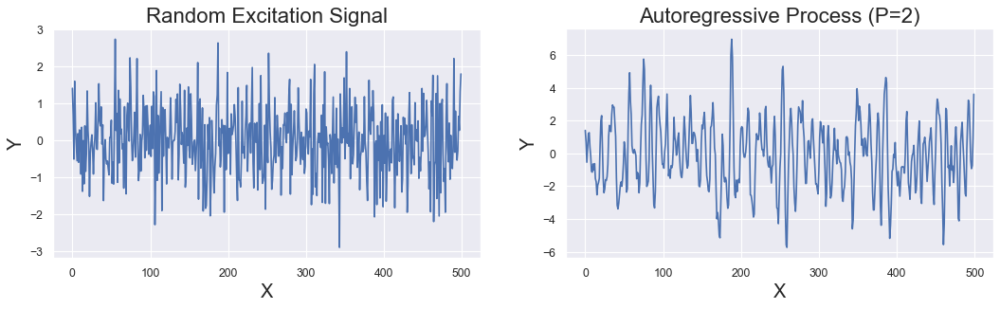

In [2]:
# Length of time series
N= 500
# Gaussian random numbers as an excitation signal
ex = np.random.randn(N)
# Second order AR Process
a = np.array([1.4, -0.7])
S = ex.copy();
for n in range(2, N):
    x = np.array([S[n-1], S[n-2]])
    S[n] = np.dot(x, a) + ex[n]

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(16,4), 
                       dpi=80, facecolor='w', edgecolor='k')
#plt.tight_layout()
ax[0].plot(range(N), ex)
ax[0].grid(True)
ax[0].set_title("Random Excitation Signal", fontsize=20)
ax[0].set_xlabel("X", fontsize=18)
ax[0].set_ylabel("Y", fontsize=18)
ax[1].plot(range(N), S)
ax[1].grid(True)
ax[1].set_title("Autoregressive Process (P=2)", fontsize=20)
ax[1].set_xlabel("X", fontsize=18)
ax[1].set_ylabel("Y", fontsize=18)
plt.savefig("ARprocess_stat.svg", format='svg', dpi=1200)

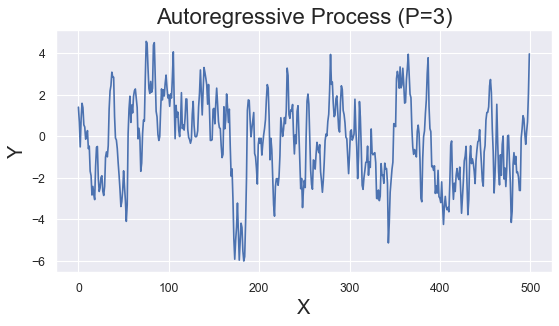

In [4]:
a2 = np.array([1.2, -0.4, 0.1])
S2 = ex.copy();
for n in range(3, N):
    x = np.array([S2[n-1], S2[n-2], S2[n-3]])
    S2[n] = np.dot(x, a2) + ex[n]

plt.figure(num=None, figsize=(8, 4), dpi=80, facecolor='w', edgecolor='k')
plt.plot(range(N), S2)
plt.grid(True)
plt.title("Autoregressive Process (P=3)", fontsize=20)
plt.xlabel("X", fontsize=18)
plt.ylabel("Y", fontsize=18)
plt.savefig("ARprocess_stat3.svg", format='svg', dpi=1200)

There is a quick, visual check that we can do to see if there is an autocorrelation in our time series dataset.

We can plot the observation at the previous time step (t-1) with the observation at the next time step (t+1) as a scatter plot.

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


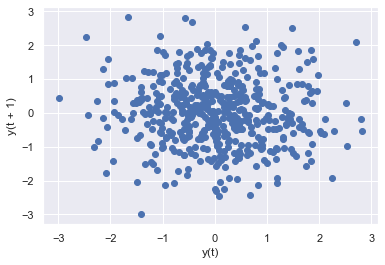

In [643]:
pd.plotting.lag_plot(pd.Series(ex))

We can plot the correlation coefficient for each lag variable.

This can very quickly give an idea of which lag variables may be good candidates for use in a predictive model and how the relationship between the observation and its historic values changes over time.

The plot provides the lag number along the x-axis and the correlation coefficient value between -1 and 1 on the y-axis. The plot also includes solid and dashed lines that indicate the 95% and 99% confidence interval for the correlation values. Correlation values above these lines are more significant than those below the line, providing a threshold or cutoff for selecting more relevant lag values.

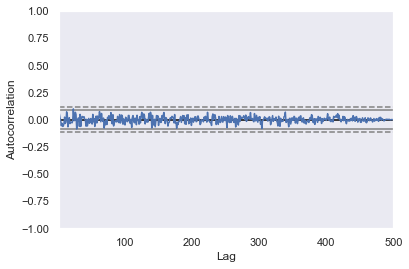

In [5]:
pd.plotting.autocorrelation_plot(pd.Series(ex))

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


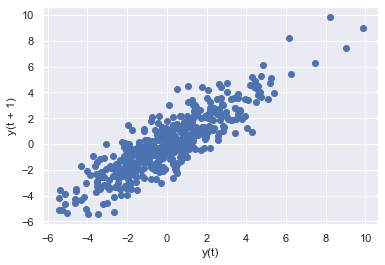

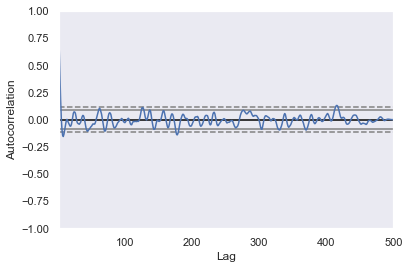

In [6]:
def corr_analysis(S):
    pd.plotting.lag_plot(pd.Series(S))
    plt.show()
    pd.plotting.autocorrelation_plot(pd.Series(S))
    plt.show()
    
corr_analysis(S)

## Generating a Time-varying AR process

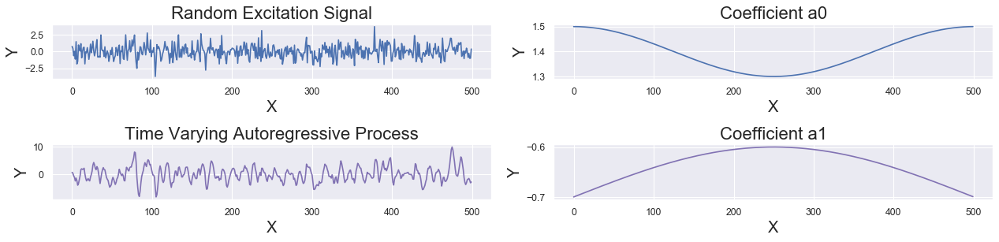

In [811]:
# Length of time series
N= 500
# Gaussian random numbers as an excitation signal
ex = np.random.randn(N)
# Second order AR Process with coefficients slowly changing in time
a0 = np.array([1.4, -0.7])
A = np.zeros((N,2))
omega, alpha = N/2, 0.1
for n in range(N):
    A[n,0] = a0[0] + alpha * np.cos(2*np.pi*n/N)
    A[n,1] = a0[1] + alpha * np.sin(np.pi*n/N)
S3 = ex.copy();
for n in range(2, N):
    x = np.array([S3[n-1], S3[n-2]])
    S3[n] = np.dot(x, A[n,:]) + ex[n]
    
fig, ax = plt.subplots(nrows=2, ncols=2, figsize=(16,4), 
                       dpi=80, facecolor='w', edgecolor='k')
# plt.figure(num=None, figsize=(6, 6), dpi=80, facecolor='w', edgecolor='k')

ax[0,0].plot(range(N), ex)
ax[0,0].grid(True)
ax[0,0].set_title("Random Excitation Signal", fontsize=20)
ax[0,0].set_xlabel("X", fontsize=18)
ax[0,0].set_ylabel("Y", fontsize=18)
ax[0,1].plot(range(N), A[:,0])
ax[0,1].grid(True)
ax[0,1].set_xlabel("X", fontsize=18)
ax[0,1].set_ylabel("Y", fontsize=18)
ax[0,1].set_title("Coefficient a0", fontsize=20)

ax[1,0].plot(range(N), S3, color= 'm')
ax[1,0].grid(True)
ax[1,0].set_xlabel("X", fontsize=18)
ax[1,0].set_ylabel("Y", fontsize=18)
ax[1,0].set_title("Time Varying Autoregressive Process", fontsize=20)
ax[1,1].plot(range(N), A[:,1], color= 'm')
ax[1,1].grid(True)
ax[1,1].set_xlabel("X", fontsize=18)
ax[1,1].set_ylabel("Y", fontsize=18)
ax[1,1].set_title("Coefficient a1", fontsize=20)

plt.tight_layout()
#plt.savefig("arChange.png")
plt.savefig("ARprocess.svg", format='svg', dpi=1200)

## Kalman Filter Estimates of second order AR parameters

In [4]:
def linear_kalman(N, y, a, b=0.001, r=0.2):
    # Time series data y
    # th_n_n: estimate at time n using all data upto time n
    # th_n_n1: estimate at time n using all data upto time n-1
    # Initialize
    ePlot = np.zeros((N, 1))
    x = np.zeros((2,1))
    th_n1_n1 = np.random.randn(2,1)
    P_n1_n1 = b*np.eye(2)
    # Noise variances -- hyperparameters (to be tuned)
    # Set measurement noise as fraction of data variance (first few samples)
    # Guess for process noise
    R = r*np.std(ex[0:10])
    beta = 0.0001
    Q = beta*np.eye(2)
    # Space to store and plot
    th_conv = np.zeros([2, N])
    # First two estimates are initial guesses
    th_conv[0,0] = th_n1_n1[0]
    th_conv[0,1] = th_n1_n1[1]
    th_conv[1,0] = th_n1_n1[0]
    th_conv[1,1] = th_n1_n1[1]
    # Kalman Iteration Loop (univariate observation, start from time step 2)
    for n in range(2, N):
    # Input vector contains past velues
        x[0] = y[n-1]
        x[1] = y[n-2]
        # Prediction of state and covariance
        th_n_n1 = th_n1_n1.copy()
        P_n_n1 = P_n1_n1 + Q
        yh = th_n_n1.T @ x
        en = y[n] - yh
        ePlot[n] = en
        # Kalman gain (kn) and innovation variance (den)
        den = x.T @ P_n1_n1 @ x + R
        kn = P_n1_n1 @ x / den
        # Posterior update
        th_n_n = th_n_n1 + kn * en
        P_n_n = (np.eye(2) - kn @ x.T) @ P_n_n1
        # Save
        th_conv[0,n] = th_n_n[0]
        th_conv[1,n] = th_n_n[1]
        # Remember for next step
        th_n1_n1 = th_n_n.copy()
        P_n1_n1 = P_n_n.copy()
    #print("Original: ",a)
    print("Estimated: ", [j for i in th_n_n for j in i])
    
    return th_conv, ePlot

#     plt.figure(num=None, figsize=(12, 8), dpi=80, facecolor='w', edgecolor='k')
#     try:
#         plt.plot(range(N), a[:,0], color='r')
#     except:
#         plt.axhline(y= a[0], color='r')
#     plt.plot(th_conv[0], label='First Parameter')
#     try:
#         plt.plot(range(N), a[:,1], color='r')
#     except:
#         plt.axhline(y= a[1], color='r')
#     plt.plot(th_conv[1], label='Second Parameter')
#     plt.legend(fontsize=18)
#     plt.title('Second order AR parameters estimates ' + 
#               '(R = ' + str(round(R, 5)) + ', Q = ' + str(round(beta, 5)) + ')', fontsize=20);
#     plt.show()
    
#     plt.figure(num=None, figsize=(8, 6), dpi=80, facecolor='w', edgecolor='k')
#     plt.plot(ePlot)
#     plt.title('Error Plot', fontsize=20);
#     plt.xlabel('Iteration Number', fontsize=18);
#     plt.ylabel('Error', fontsize=18);
    
# linear_kalman(N, S3, A)
#linear_kalman(N, S, a)

In [813]:
# numpy. random. randn is the function to produce a sample (or samples) from the “standard normal” distribution. 
# An array of random numbers: numbers in the array follow the normal distribution.
# th_n1_n1 = np.random.randn(2,1)
# th_n1_n1

In [6]:
th_conv1, ePlot1 = linear_kalman(N, S, a)
th_conv2, ePlot2 = linear_kalman(N, S, a)
th_conv3, ePlot3 = linear_kalman(N, S, a)
th_conv4, ePlot4 = linear_kalman(N, S, a)
th_conv5, ePlot5 = linear_kalman(N, S, a)

Estimated:  [1.334425493892451, -0.684769128507497]
Estimated:  [1.334381259444452, -0.6847258222790905]
Estimated:  [1.3343388715624476, -0.6846843238686895]
Estimated:  [1.334342729103016, -0.6846881004620942]
Estimated:  [1.3343496547547233, -0.6846948807853737]


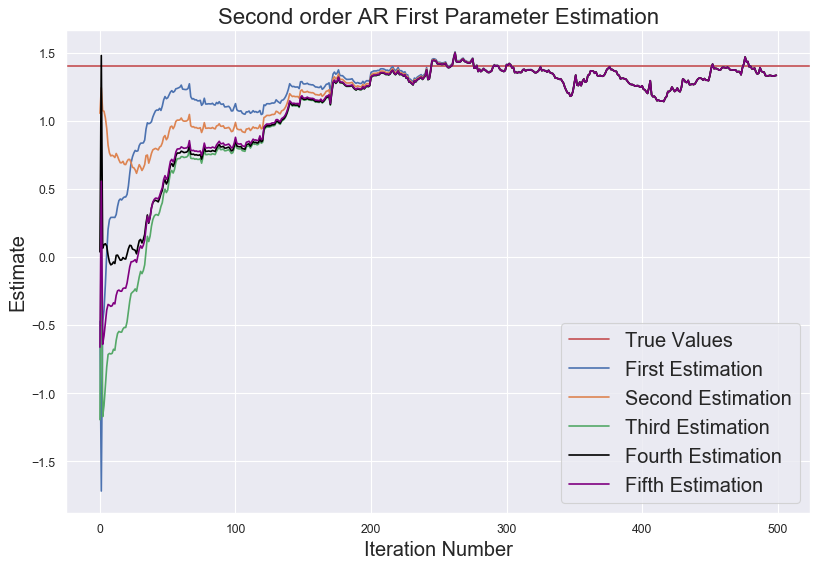

In [7]:
plt.figure(num=None, figsize=(12, 8), dpi=80, facecolor='w', edgecolor='k')
plt.axhline(y= a[0], color='r', label='True Values') # plt.plot(range(N), A[:,0], color='r', label='True Values')
plt.plot(th_conv1[0], label='First Estimation')
plt.plot(th_conv2[0], label='Second Estimation')
plt.plot(th_conv3[0], label='Third Estimation')
plt.plot(th_conv4[0], label='Fourth Estimation', color='black')
plt.plot(th_conv5[0], label='Fifth Estimation', color='purple')
plt.legend(fontsize=18)
plt.title('Second order AR First Parameter Estimation', fontsize=20);
plt.xlabel('Iteration Number', fontsize=18);
plt.ylabel('Estimate', fontsize=18);
plt.savefig("first_par.svg", format='svg', dpi=1200)
plt.show()

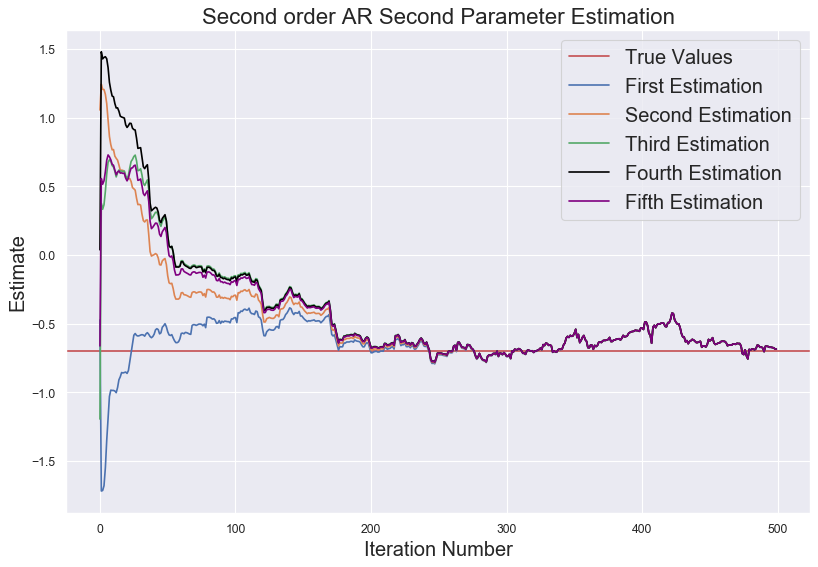

In [8]:
plt.figure(num=None, figsize=(12, 8), dpi=80, facecolor='w', edgecolor='k')
plt.axhline(y= a[1], color='r', label='True Values') #plt.plot(range(N), A[:,1], color='r', label='True Values')
plt.plot(th_conv1[1], label='First Estimation')
plt.plot(th_conv2[1], label='Second Estimation')
plt.plot(th_conv3[1], label='Third Estimation')
plt.plot(th_conv4[1], label='Fourth Estimation', color='black')
plt.plot(th_conv5[1], label='Fifth Estimation', color='purple')
plt.legend(fontsize=18)
plt.title('Second order AR Second Parameter Estimation', fontsize=20);
plt.xlabel('Iteration Number', fontsize=18);
plt.ylabel('Estimate', fontsize=18);
plt.savefig("second_par.svg", format='svg', dpi=1200)
plt.show()

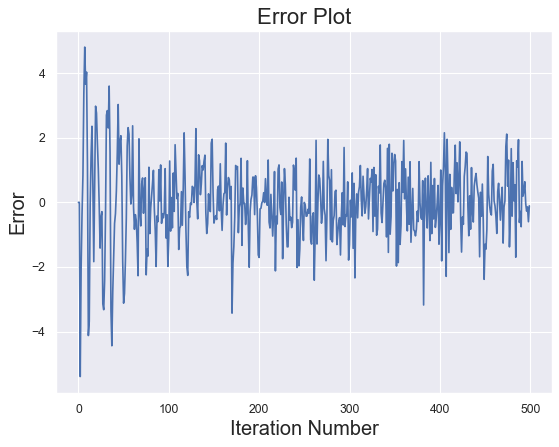

In [12]:
plt.figure(num=None, figsize=(8, 6), dpi=80, facecolor='w', edgecolor='k')
plt.plot(ePlot4)
plt.title('Error Plot', fontsize=20);
plt.xlabel('Iteration Number', fontsize=18);
plt.ylabel('Error', fontsize=18);
plt.savefig("error_plot.svg", format='svg', dpi=1200)

In [22]:
# th_conv_t, ePlot_t = linear_kalman(N, S3, A, b=0.005, r=0.2)
# th_conv_t1, ePlot_t = linear_kalman(N, S3, A, b=0.001, r=0.7)
# th_conv_t2, ePlot_t = linear_kalman(N, S3, A, b=0.005, r=0.7)
# th_conv_t3, ePlot_t = linear_kalman(N, S3, A, b=0.0005, r=0.2)
# th_conv_t4, ePlot_t = linear_kalman(N, S3, A, b=0.001, r=0.1)
# th_conv_t5, ePlot_t = linear_kalman(N, S3, A, b=0.0005, r=0.1)
# th_conv_t, ePlot_t = linear_kalman(N, S, a, b=0.0005, r=0.2)
# th_conv_t1, ePlot_t = linear_kalman(N, S, a, b=0.001, r=0.2)
# th_conv_t2, ePlot_t = linear_kalman(N, S, a, b=0.05, r=0.2)
# th_conv_t3, ePlot_t = linear_kalman(N, S, a, b=0.19, r=0.2)
# th_conv_t4, ePlot_t = linear_kalman(N, S, a, b=0.22, r=0.2)
# th_conv_t5, ePlot_t = linear_kalman(N, S, a, b=0.28, r=0.2)
# th_conv_t, ePlot_t = linear_kalman(N, S, a, b=0.001, r=0.01)
# th_conv_t1, ePlot_t = linear_kalman(N, S, a, b=0.001, r=0.1)
# th_conv_t2, ePlot_t = linear_kalman(N, S, a, b=0.001, r=0.5)
# th_conv_t3, ePlot_t = linear_kalman(N, S, a, b=0.001, r=1.1)
# th_conv_t4, ePlot_t = linear_kalman(N, S, a, b=0.001, r=1.5)
# th_conv_t5, ePlot_t = linear_kalman(N, S, a, b=0.001, r=2.5)
th_conv_t, ePlot_t = linear_kalman(N, S, a, b=0.001, r=0.01)
th_conv_t1, ePlot_t = linear_kalman(N, S, a, b=0.01, r=0.1)
th_conv_t2, ePlot_t = linear_kalman(N, S, a, b=0.05, r=0.5)
th_conv_t3, ePlot_t = linear_kalman(N, S, a, b=0.1, r=1.1)
th_conv_t4, ePlot_t = linear_kalman(N, S, a, b=0.15, r=1.5)
th_conv_t5, ePlot_t = linear_kalman(N, S, a, b=0.2, r=2.5)

Estimated:  [1.2580707138679874, -0.7066485153106211]
Estimated:  [1.3273492659837778, -0.697127706286607]
Estimated:  [1.3370436412527238, -0.6673426777913376]
Estimated:  [1.3345771840479184, -0.6533940799359246]
Estimated:  [1.334059473299637, -0.6496871253552124]
Estimated:  [1.3361461333471465, -0.6478532410638216]


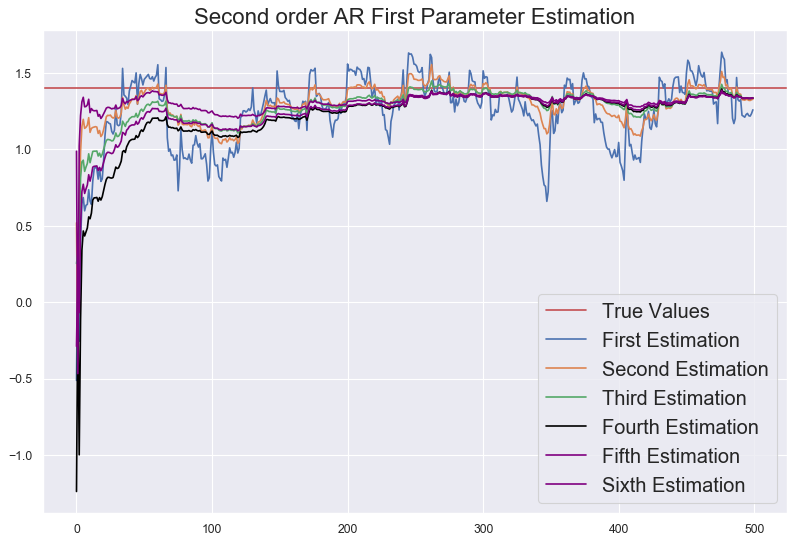

In [23]:
plt.figure(num=None, figsize=(12, 8), dpi=80, facecolor='w', edgecolor='k')
plt.axhline(y= a[0], color='r', label='True Values')
plt.plot(th_conv_t[0], label='First Estimation')
plt.plot(th_conv_t1[0], label='Second Estimation')
plt.plot(th_conv_t2[0], label='Third Estimation')
plt.plot(th_conv_t3[0], label='Fourth Estimation', color='black')
plt.plot(th_conv_t4[0], label='Fifth Estimation', color='purple')
plt.plot(th_conv_t5[0], label='Sixth Estimation', color='purple')
plt.legend(fontsize=18)
plt.title('Second order AR First Parameter Estimation', fontsize=20);
plt.show()

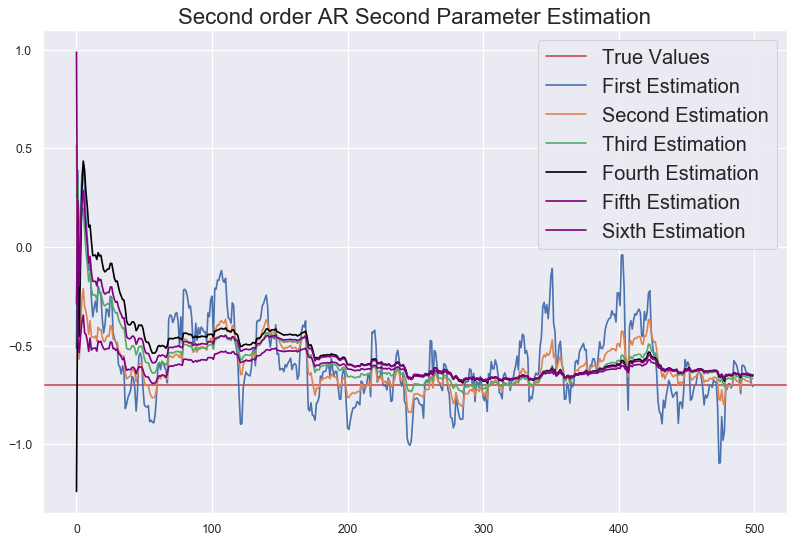

In [24]:
plt.figure(num=None, figsize=(12, 8), dpi=80, facecolor='w', edgecolor='k')
plt.axhline(y= a[1], color='r', label='True Values')
plt.plot(th_conv_t[1], label='First Estimation')
plt.plot(th_conv_t1[1], label='Second Estimation')
plt.plot(th_conv_t2[1], label='Third Estimation')
plt.plot(th_conv_t3[1], label='Fourth Estimation', color='black')
plt.plot(th_conv_t4[1], label='Fifth Estimation', color='purple')
plt.plot(th_conv_t5[1], label='Sixth Estimation', color='purple')
plt.legend(fontsize=18)
plt.title('Second order AR Second Parameter Estimation', fontsize=20);
plt.show()

Original:  [ 1.2 -0.4  0.1]
Estimated:  [1.1378875832026043, -0.3670033983694269, 0.05626800273812825]


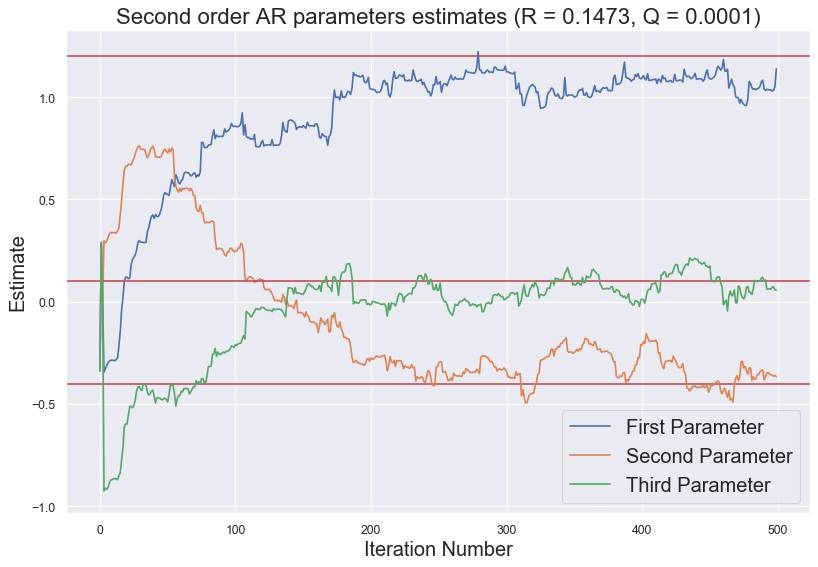

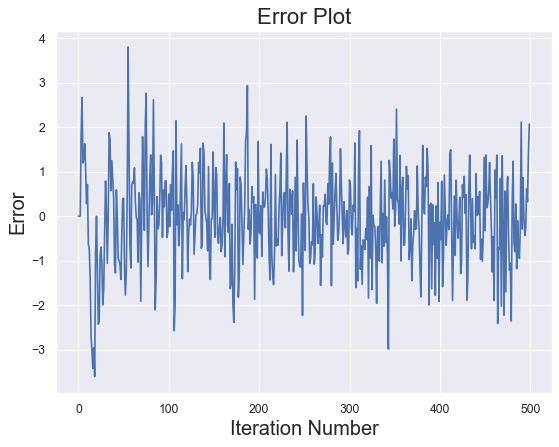

In [6]:
def linear_kalman2(N, y, a):
    # Time series data y
    # th_n_n: estimate at time n using all data upto time n
    # th_n_n1: estimate at time n using all data upto time n-1
    # Initialize
    ePlot = np.zeros((N, 1))
    x = np.zeros((3,1))
    th_n1_n1 = np.random.randn(3,1)
    P_n1_n1 = 0.001*np.eye(3)
    # Noise variances -- hyperparameters (to be tuned)
    # Set measurement noise as fraction of data variance (first few samples)
    # Guess for process noise
    R = 0.2*np.std(ex[0:10])
    beta = 0.0001
    Q = beta*np.eye(3)
    # Space to store and plot
    th_conv = np.zeros([3, N])
    # First two estimates are initial guesses
    th_conv[0,0] = th_n1_n1[0]
    th_conv[0,1] = th_n1_n1[1]
    th_conv[1,0] = th_n1_n1[0]
    th_conv[1,1] = th_n1_n1[1]
    th_conv[2,0] = th_n1_n1[0]
    th_conv[2,1] = th_n1_n1[1]
    # Kalman Iteration Loop (univariate observation, start from time step 2)
    for n in range(3, N):
    # Input vector contains past velues
        x[0] = y[n-1]
        x[1] = y[n-2]
        x[2] = y[n-3]
        # Prediction of state and covariance
        th_n_n1 = th_n1_n1.copy()
        P_n_n1 = P_n1_n1 + Q
        yh = th_n_n1.T @ x
        en = y[n] - yh
        ePlot[n] = en
        # Kalman gain (kn) and innovation variance (den)
        den = x.T @ P_n1_n1 @ x + R
        kn = P_n1_n1 @ x / den
        # Posterior update
        th_n_n = th_n_n1 + kn * en
        P_n_n = (np.eye(3) - kn @ x.T) @ P_n_n1
        # Save
        th_conv[0,n] = th_n_n[0]
        th_conv[1,n] = th_n_n[1]
        th_conv[2,n] = th_n_n[2]
        # Remember for next step
        th_n1_n1 = th_n_n.copy()
        P_n1_n1 = P_n_n.copy()
    print("Original: ",a)
    print("Estimated: ", [j for i in th_n_n for j in i])

    plt.figure(num=None, figsize=(12, 8), dpi=80, facecolor='w', edgecolor='k')
    try:
        plt.plot(range(N), a[:,0], color='r')
    except:
        plt.axhline(y= a[0], color='r')
    plt.plot(th_conv[0], label='First Parameter')
    try:
        plt.plot(range(N), a[:,1], color='r')
    except:
        plt.axhline(y= a[1], color='r')
    plt.plot(th_conv[1], label='Second Parameter')
    try:
        plt.plot(range(N), a[:,2], color='r')
    except:
        plt.axhline(y= a[2], color='r')
    plt.plot(th_conv[2], label='Third Parameter')
    plt.legend(fontsize=18)
    plt.title('Second order AR parameters estimates ' + 
              '(R = ' + str(round(R, 5)) + ', Q = ' + str(round(beta, 5)) + ')', fontsize=20);
    plt.xlabel('Iteration Number', fontsize=18);
    plt.ylabel('Estimate', fontsize=18);
    plt.savefig("tree_par.svg", format='svg', dpi=1200)
    plt.figure(num=None, figsize=(8, 6), dpi=80, facecolor='w', edgecolor='k')
    plt.plot(ePlot)
    plt.title('Error Plot', fontsize=20);
    plt.xlabel('Iteration Number', fontsize=18);
    plt.ylabel('Error', fontsize=18);
    
linear_kalman2(N, S2, a2)

## Partile Filter Estimates of second order AR parameters

### A distribution of random particles in 2D

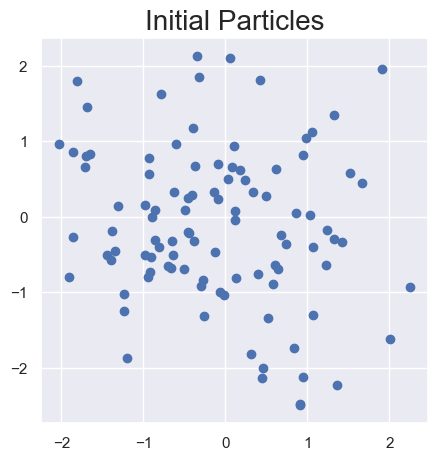

In [219]:
sns.set()

Ns = 100
# Initial particles
parts = np.random.randn(Ns, 2)
fig, ax = plt.subplots(figsize=(5,5))
ax.scatter(parts[:,0], parts[:,1], color='b')
ax.grid(True)
ax.set_title("Initial Particles", fontsize=20);
ax.set_xlabel("X", fontsize=18)
ax.set_ylabel("Y", fontsize=18)
plt.savefig("particles.svg", format='svg', dpi=1200)

In [767]:
sns.reset_orig()

### Algorithm 1: Sequential Monte Carlo

0.04608424186389043 -0.05178239309502119


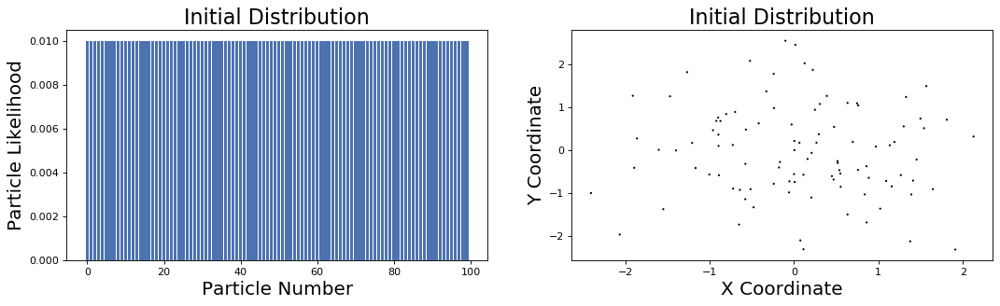

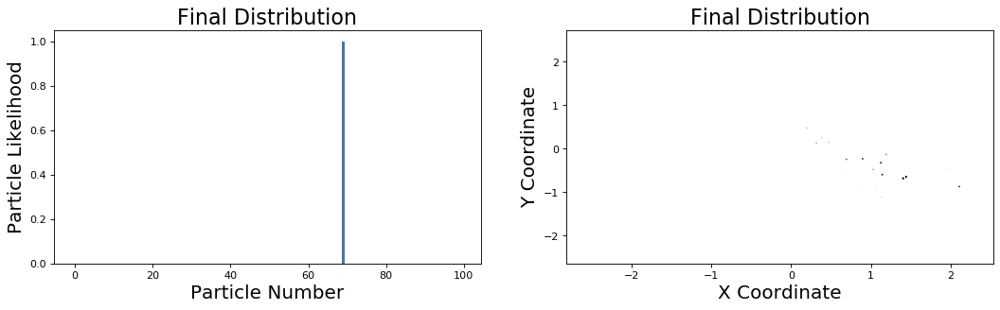

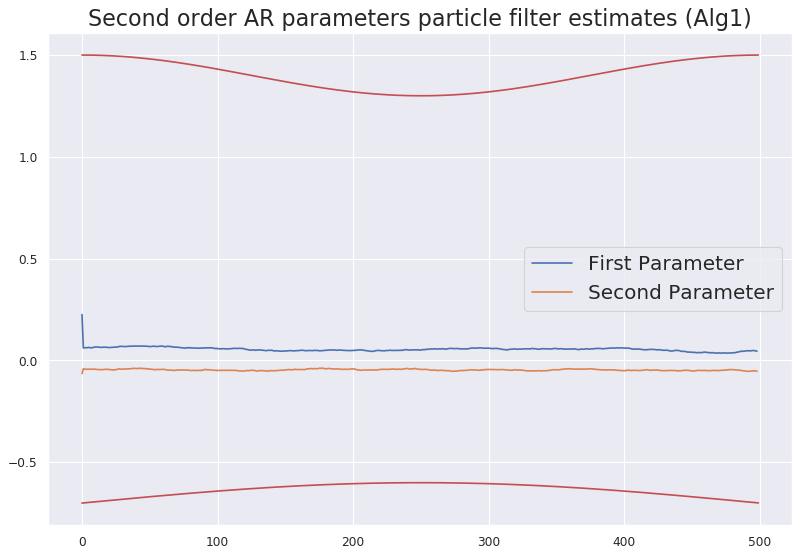

In [764]:
# Likelihood from Gaussian noise 
# Needs estimate, true value and noise variance 
def particle_likelihood(y0, yh, sig): 
    lhood = (1/(2*np.pi*sig))*np.exp(-0.5*(y0-yh)**2) 
    return lhood

itern = 500

# Process noise covariance is beta*I 
beta = 0.01

coef1 = [np.mean(parts[:, 0])]
coef2 = [np.mean(parts[:, 1])]
coef1_min = [np.min(parts[:, 0])]
coef1_max = [np.max(parts[:, 0])]
coef2_min = [np.min(parts[:, 1])]
coef2_max = [np.max(parts[:, 1])]

# Observation noise variance 
sig = np.std(ex)

parts = np.random.randn(Ns, 2)
# Initial input vector and particle weights 
x = np.zeros((2,1)) 
pweights = np.ones((Ns,1)) / Ns

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(16,4), 
                       dpi=80, facecolor='w', edgecolor='k')
ax[0].bar(np.arange(len(pweights)), pweights[:, 0], color='b')
ax[0].set_xlabel("Particle Number", fontsize=18)
ax[0].set_ylabel("Particle Likelihood", fontsize=18)
ax[0].set_title("Initial Distribution", fontsize=20)
ax[1].scatter(parts[:, 0], parts[:, 1], s= pweights**0.01, color='black')
ax[1].set_xlabel("X Coordinate", fontsize=18)
ax[1].set_ylabel("Y Coordinate", fontsize=18)
ax[1].set_title("Initial Distribution", fontsize=20)
plt.savefig("Alg1_init.svg", format='svg', dpi=1200, bbox_inches='tight')

# Go over the data 
for n in range(2, itern): 
    x[0] = S3[n-1] 
    x[1] = S3[n-2]

    # Sample particles from the prior 
    # (in the simplest case here, random perturbation) 
    for p in range(Ns): 
        parts[p,:] = parts[p,:] + beta*np.random.randn(1,2)

    # Predictions and likelihoods
    sh = np.zeros((Ns, 1)) 
    lhoods = sh.copy() 
    for particle in range(Ns): 
        th = parts[particle,:].T.copy() 
        sh[particle] = x.T @ th 
        lhoods[particle] = particle_likelihood(S3[n], sh[particle], sig)

    # multiply prior weigts by likelihoods and normalize 
    pweights = pweights * lhoods 
    pweights = pweights / np.sum(pweights)
    
    coef1.append(np.mean(parts[:, 0])) 
    coef2.append(np.mean(parts[:, 1]))
    coef1_max.append(np.max(parts[:, 0])) 
    coef1_min.append(np.min(parts[:, 0]))
    coef2_max.append(np.max(parts[:, 1])) 
    coef2_min.append(np.min(parts[:, 1]))

# Observe how the weights change as you update 
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(16,4), 
                       dpi=80, facecolor='w', edgecolor='k')
ax[0].bar(np.arange(len(pweights)), pweights[:, 0], color='b')
ax[0].set_xlabel("Particle Number", fontsize=18)
ax[0].set_ylabel("Particle Likelihood", fontsize=18)
ax[0].set_title("Final Distribution", fontsize=20)
ax[1].scatter(parts[:, 0], parts[:, 1], s= pweights**0.01, color='black')
ax[1].set_xlabel("X Coordinate", fontsize=18)
ax[1].set_ylabel("Y Coordinate", fontsize=18)
ax[1].set_title("Final Distribution", fontsize=20)
print(np.mean(parts[:, 0]), np.mean(parts[:, 1]))
plt.savefig("Alg1.svg", format='svg', dpi=1200, bbox_inches='tight')
sns.set()
plt.figure(num=None, figsize=(12, 8), dpi=80, facecolor='w', edgecolor='k')
plt.plot(range(itern-1), coef1, label='First Parameter')
plt.plot(range(itern-1), coef2, label='Second Parameter')
#plt.axhline(y= a[0], color='r')
#plt.axhline(y= a[1], color='r')
plt.plot(range(itern), A[:,0], color='r')
plt.plot(range(itern), A[:,1], color='r')
#plt.fill_between(range(itern-1), coef1_min, coef1_max, color='b', alpha=.1)
#plt.fill_between(range(itern-1), coef2_min, coef2_max, color='orange', alpha=.1)
plt.legend(fontsize=18)
plt.title('Second order AR parameters particle filter estimates (Alg1)', fontsize=20)
plt.savefig("Alg1_parameter_est.svg", format='svg', dpi=1200)
sns.reset_orig()

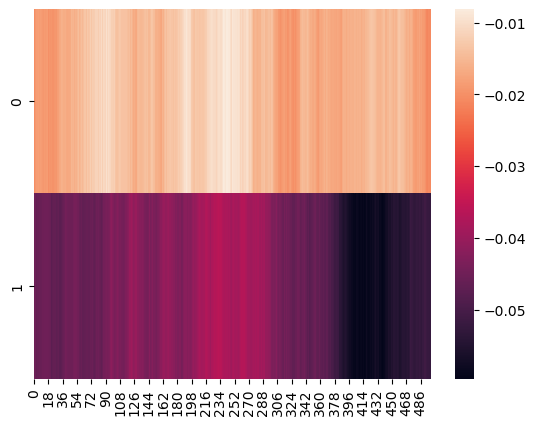

In [13]:
ax = sns.heatmap([coef1, coef2])

### Algorithm 2: Particle Filter with Resampling

1.3908458660936482 -0.6812462216835584


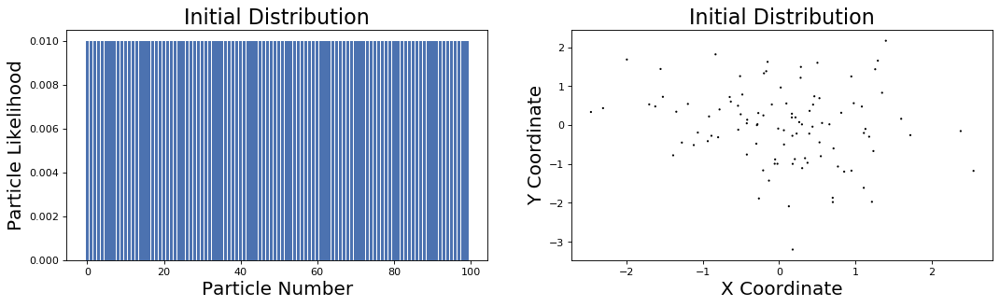

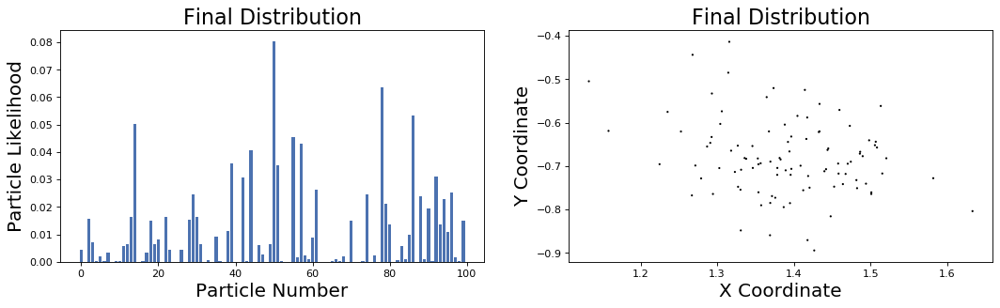

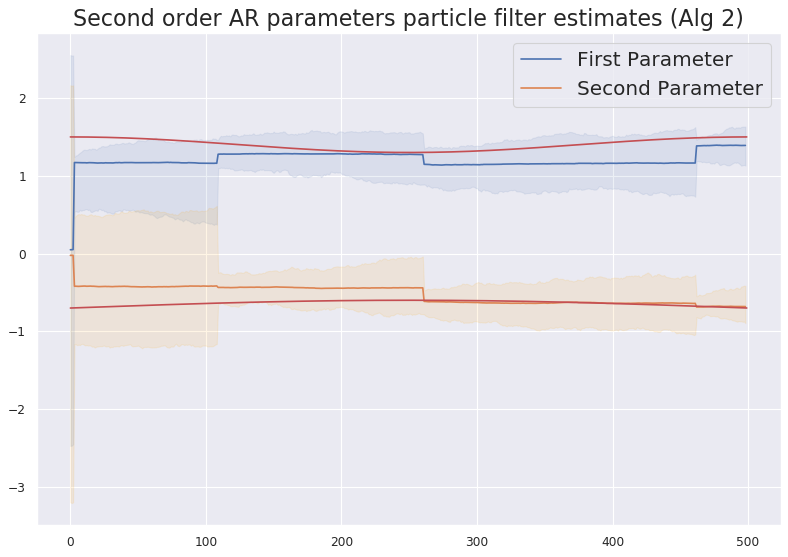

In [759]:
itern = 500
threshold = 5
# Process noise covariance is beta*I 
beta = 0.01

# Observation noise variance 
sig = np.std(ex)

parts = np.random.randn(Ns, 2)
# Initial input vector and particle weights 
x = np.zeros((2,1)) 
pweights = np.ones((Ns,1)) / Ns

x_res = []
y_res = []
x_res.extend(parts[:, 0])
y_res.extend(parts[:, 1])
coef1 = [np.mean(parts[:, 0])]
coef2 = [np.mean(parts[:, 1])]
coef1_min = [np.min(parts[:, 0])]
coef1_max = [np.max(parts[:, 0])]
coef2_min = [np.min(parts[:, 1])]
coef2_max = [np.max(parts[:, 1])]

fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(16,4), 
                       dpi=80, facecolor='w', edgecolor='k')
ax[0].bar(np.arange(len(pweights)), pweights[:, 0], color='b')
ax[0].set_xlabel("Particle Number", fontsize=18)
ax[0].set_ylabel("Particle Likelihood", fontsize=18)
ax[0].set_title("Initial Distribution", fontsize=20)
ax[1].scatter(parts[:, 0], parts[:, 1], s= pweights**0.01, color='black')
ax[1].set_xlabel("X Coordinate", fontsize=18)
ax[1].set_ylabel("Y Coordinate", fontsize=18)
ax[1].set_title("Initial Distribution", fontsize=20)
plt.savefig("Alg1_init2.svg", format='svg', dpi=1200, bbox_inches='tight')

# Go over the data 
for n in range(2, itern):
    x[0] = S3[n-1] 
    x[1] = S3[n-2]

    # Sample particles from the prior 
    # (in the simplest case here, random perturbation) 
    for p in range(Ns): 
        parts[p,:] = parts[p,:] + beta*np.random.randn(1,2)

    # Predictions and likelihoods
    sh = np.zeros((Ns, 1)) 
    lhoods = sh.copy() 
    for particle in range(Ns): 
        th = parts[particle,:].T.copy() 
        sh[particle] = x.T @ th 
        lhoods[particle] = particle_likelihood(S3[n], sh[particle], sig)

    # multiply prior weigts by likelihoods and normalize 
    pweights = pweights * lhoods 
    pweights = pweights / np.sum(pweights)
    
    n_eff = 1/sum([i**2 for i in pweights])
    if n_eff < threshold:
        c1 = []
        s = 0
        for i in pweights:
            s += i
            c1.append(*s)
        new_parts = np.zeros((Ns, 2))
        for j in range(0, Ns):
            num = random.uniform(0, 1)
            for i in range(0, len(c1)):
                if c1[i] > num and num > c1[i-1]:
                    new_parts[j] = parts[i]

        parts = new_parts
        pweights = np.ones((Ns,1)) / Ns
    
    coef1.append(np.mean(parts[:, 0])) 
    coef2.append(np.mean(parts[:, 1]))
    coef1_max.append(np.max(parts[:, 0])) 
    coef1_min.append(np.min(parts[:, 0]))
    coef2_max.append(np.max(parts[:, 1])) 
    coef2_min.append(np.min(parts[:, 1]))
    x_res.extend(parts[:, 0])
    y_res.extend(parts[:, 1])
# Observe how the weights change as you update 
fig, ax = plt.subplots(nrows=1, ncols=2, figsize=(16,4), 
                       dpi=80, facecolor='w', edgecolor='k')
ax[0].bar(np.arange(len(pweights)), pweights[:, 0], color='b')
ax[0].set_xlabel("Particle Number", fontsize=18)
ax[0].set_ylabel("Particle Likelihood", fontsize=18)
ax[0].set_title("Final Distribution", fontsize=20)
ax[1].scatter(parts[:, 0], parts[:, 1], s= pweights**0.01, color='black')
ax[1].set_xlabel("X Coordinate", fontsize=18)
ax[1].set_ylabel("Y Coordinate", fontsize=18)
ax[1].set_title("Final Distribution", fontsize=20)
print(np.mean(parts[:, 0]), np.mean(parts[:, 1]))
plt.savefig("Alg2.svg", format='svg', dpi=1200, bbox_inches='tight')
sns.set()
plt.figure(num=None, figsize=(12, 8), dpi=80, facecolor='w', edgecolor='k')
plt.plot(range(itern-1), coef1, label='First Parameter')
plt.plot(range(itern-1), coef2, label='Second Parameter')
# plt.axhline(y= a[0], color='r')
# plt.axhline(y= a[1], color='r')
plt.plot(range(itern), A[:,0], color='r')
plt.plot(range(itern), A[:,1], color='r')
plt.fill_between(range(itern-1), coef1_min, coef1_max, color='b', alpha=.1)
plt.fill_between(range(itern-1), coef2_min, coef2_max, color='orange', alpha=.1)
plt.legend(fontsize=18)
plt.title('Second order AR parameters particle filter estimates (Alg 2)', fontsize=20)
plt.savefig("Alg2_parameter_est.svg", format='svg', dpi=1200)
sns.reset_orig()

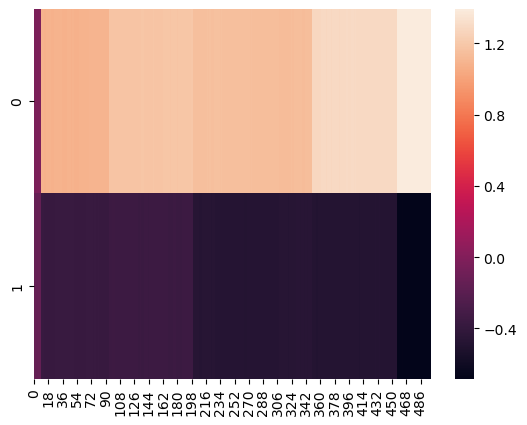

In [748]:
ax = sns.heatmap([coef1, coef2])

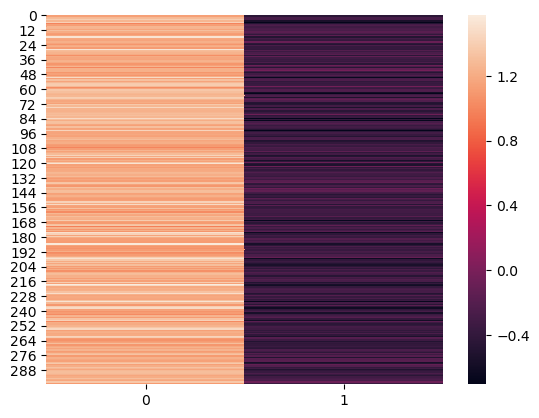

In [16]:
ax = sns.heatmap(parts)

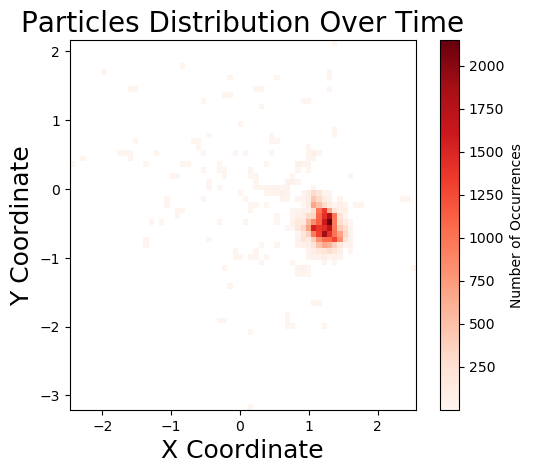

In [760]:
heatmap, xedges, yedges = np.histogram2d(x_res, y_res, bins=(66, 64))
extent = [xedges[0], xedges[-1], yedges[0], yedges[-1]]

plt.clf()

my_cmap = plt.get_cmap('Reds') #plt.cm.jet #plt.cm.get_cmap('rainbow')
my_cmap.set_under('w')

im = plt.imshow(heatmap.T, extent=extent, cmap= my_cmap, vmin=.001, origin='lower')
cb = plt.colorbar(im)
cb.set_label('Number of Occurrences')
plt.xlabel("X Coordinate", fontsize=18)
plt.ylabel("Y Coordinate", fontsize=18)
plt.title("Particles Distribution Over Time", fontsize=20)
plt.savefig("HeatMap.svg", format='svg', dpi=1200)
plt.show()

In [233]:
# Process noise covariance is beta*I 
beta = 0.01

# Observation noise variance 
sig = np.std(ex)

parts = np.random.randn(Ns, 2)
# Initial input vector and particle weights 
x = np.zeros((2,1)) 
pweights = np.ones((Ns,1)) / Ns

fig = plt.figure()
ax = [plt.subplot2grid((1,2), (0,i), colspan=1, rowspan=1) for i in range(2)]
camera = Camera(fig)

#ax.bar(np.arange(len(pweights)), pweights[:, 0])

# Go over the data 
for n in range(2, 100): 
    x[0] = S3[n-1] 
    x[1] = S3[n-2]

    # Sample particles from the prior 
    # (in the simplest case here, random perturbation) 
    for p in range(Ns): 
        parts[p,:] = parts[p,:] + beta*np.random.randn(1,2)

    # Predictions and likelihoods
    sh = np.zeros((Ns, 1)) 
    lhoods = sh.copy() 
    for particle in range(Ns): 
        th = parts[particle,:].T.copy() 
        sh[particle] = x.T @ th 
        lhoods[particle] = particle_likelihood(S3[n], sh[particle], sig)

    # multiply prior weigts by likelihoods and normalize 
    pweights = pweights * lhoods 
    pweights = pweights / np.sum(pweights)
    
    n_eff = 1/sum([i**2 for i in pweights])
    if n_eff < threshold:
        c1 = []
        s = 0
        for i in pweights:
            s += i
            c1.append(*s)
        new_parts = np.zeros((Ns, 2))
        for j in range(0, Ns):
            num = random.uniform(0, 1)
            for i in range(0, len(c1)):
                if c1[i] > num and num > c1[i-1]:
                    new_parts[j] = parts[i]

        parts = new_parts
        pweights = np.ones((Ns,1)) / Ns 

#   Observe how the weights change as you update 
    ax[0].bar(np.arange(len(pweights)), pweights[:, 0], color='b')
    ax[0].set_xlabel("Particle Number", fontsize=18)
    ax[0].set_ylabel("Particle Likelihood", fontsize=18)
    ax[0].set_title("Final Distribution", fontsize=20)
    ax[1].scatter(parts[:, 0], parts[:, 1], s= pweights**0.01, color='black')
    ax[1].set_xlabel("X Coordinate", fontsize=18)
    ax[1].set_ylabel("Y Coordinate", fontsize=18)
    ax[1].set_title("Final Distribution", fontsize=20)
    camera.snap()

print(np.mean(parts[:, 0]), np.mean(parts[:, 1]))
animation = camera.animate()
plt.tight_layout()
plt.close()
HTML(animation.to_jshtml())
animation.save('Alg2_anim.mp4')

0.9828217043003756 -0.3660984666902096


## Generating Data for Logistic Regression Classifier

[Lab Link](https://secure.ecs.soton.ac.uk/notes/comp6245/COMP6245_LabTwo.pdf)

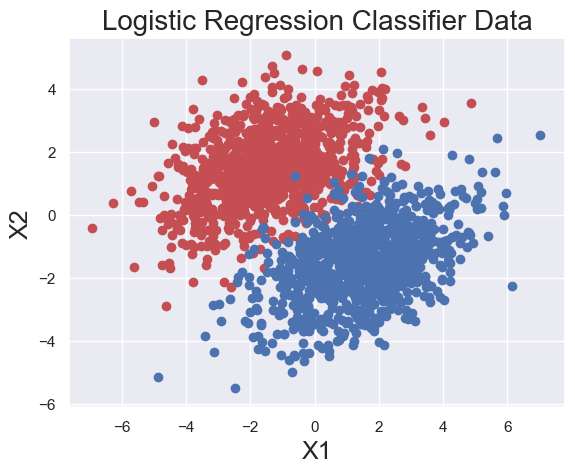

In [920]:
sns.set()

NumDataPerClass = 1000

a1, a2 = -1.5, 1.5
m1 = [[a1, a2]]
m2 = [[a2, a1]]
C = [[2, 1], [1, 2]]

A = np.linalg.cholesky(C)

X1 = np.random.randn(NumDataPerClass, 2)
X_1 = X1 @ A + m1

X2 = np.random.randn(NumDataPerClass, 2)
X_2 = X2 @ A + m2

plt.scatter(X_1[:,0], X_1[:,1], c="r")
plt.scatter(X_2[:,0], X_2[:,1], c="b")
plt.xlabel("X1", fontsize=18)
plt.ylabel("X2", fontsize=18)
plt.title('Logistic Regression Classifier Data', fontsize=20)
plt.savefig("data_dist.svg", format='svg', dpi=1200, bbox_inches='tight')

In [921]:
X_3 = np.ones((len(X_1), 1))
X_1 = np.hstack((X_1,X_3))
X_2 = np.hstack((X_2,X_3))

In [922]:
X = np.concatenate((X_1, X_2))
labelPos = np.ones(NumDataPerClass)
labelNeg = np.zeros(NumDataPerClass)
Y = np.concatenate((labelPos, labelNeg))

In [923]:
X2 = StandardScaler().fit_transform(X)

X_Train, X_Test, Y_Train, Y_Test = train_test_split(X, Y, test_size = 0.30, random_state = 101, shuffle=True)
N = len(X_Train)

In [924]:
def sig(x): 
    return 1/(1 + np.exp(-x))

def sig_div(x):
    return sig(x)*(1-sig(x))

In [925]:
def predict(X, params):
    return np.round(sig(X @ params))

In [932]:
def plot_dist(X, Y, th_conv, N, end):
    if end == False:
        slope = -(th_conv[1,0] / th_conv[2,0])
        intercept = -(th_conv[0,0] / th_conv[2,0])
    else:
        slope = -(th_conv[1,N-1] / th_conv[2,N-1])
        intercept = -(th_conv[0,N-1] / th_conv[2, N-1])
    classes = [1, 0]
    colors = ['r', 'b']
    for clas, color in zip(classes, colors):
        plt.scatter(X[Y == clas][:, 0], 
                    X[Y == clas][:, 1], c = color)
    ax = plt.gca()
    ax.autoscale(False)
    x_vals = np.array(ax.get_xlim())
    y_vals = intercept + (slope * x_vals)
    plt.plot(x_vals, y_vals, c="k");
    plt.title('Logistic Regression Classifier Data', fontsize=20)
    plt.xlabel("X1", fontsize=18)
    plt.ylabel("X2", fontsize=18)
#     plt.title('Logistic Regression Class Boundary Random Guess', fontsize=20)
#     plt.savefig("Logistic_Regression_Class_Boundary.svg", format='svg', dpi=1200, bbox_inches='tight')
    plt.title('Logistic Regression Converged Class Boundary', fontsize=20)
    plt.savefig("Logistic_Regression_Class_Boundary_Final.svg", format='svg', dpi=1200, bbox_inches='tight')
#     plt.title('Logistic Regression Test Data Class Boundary', fontsize=20)
#     plt.savefig("Logistic_Regression_Class_Boundary_Test.svg", format='svg', dpi=1200, bbox_inches='tight')

In [915]:
def plot_dist_anim(X, Y, th_conv, N):
    fig = plt.figure()
    camera = Camera(fig)

    for n in range(0, N):
        slope = -(th_conv[1,n-1] / th_conv[2,n-1])
        intercept = -(th_conv[0,n-1] / th_conv[2, n-1])
        classes = [1, 0]
        colors = ['r', 'b']
        for clas, color in zip(classes, colors):
            plt.scatter(X[Y == clas][:, 0], 
                        X[Y == clas][:, 1], c = color)
        ax = plt.gca()
        ax.autoscale(False)
        x_vals = np.array(ax.get_xlim())
        y_vals = intercept + (slope * x_vals)
        plt.plot(x_vals, y_vals, c="k");
        plt.xlabel("X1", fontsize=18)
        plt.ylabel("X2", fontsize=18)
        plt.title('Logistic Regression Class Boundary', fontsize=20)
        camera.snap()

    animation = camera.animate()
    animation.save('Boundary_anim2.mp4')
    plt.close()
    return animation

Estimated:  [-1.0998280393257283, 1.413166957928122, 0.30340177502123655]


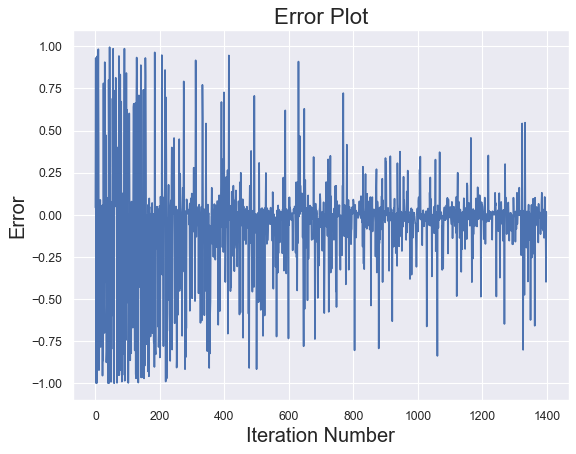

In [926]:
def extended_kalman(X, Y, N):
    # Initialize
    ePlot = np.zeros((N, 1))
    #x = np.zeros((2,1))
    th_n1_n1 = np.random.randn(len(X[0]),1)
    P_n1_n1 = 0.001*np.eye(len(X[0]))
    # Noise variances -- hyperparameters (to be tuned)
    # Set measurement noise as fraction of data variance (first few samples)
    # Guess for process noise
    R = 0.2*np.std(X[0:10])
    beta = 0.0001
    Q = beta*np.eye(len(X[0]))
    # Space to store and plot
    th_conv = np.zeros([len(X[0]), N])
    # Kalman Iteration Loop (univariate observation, start from time step 2)
    for n in range(0, N):
    # Input vector contains past velues
        x = X[n].reshape(len(X[n]),1)
        # Prediction of state and covariance
        th_n_n1 = th_n1_n1.copy()
        P_n_n1 = P_n1_n1 + Q
        yh = sig(th_n_n1.T @ x)
        en = Y[n] - yh
        ePlot[n] = en
        # Kalman gain (kn) and innovation variance (den)
        den = (sig_div(yh)*x).T @ P_n1_n1 @ (sig_div(yh)*x) + R
        kn = (P_n1_n1 @ (sig_div(yh)*x)) / den
        # Posterior update
        th_n_n = th_n_n1 + kn * en
        P_n_n = (np.eye(len(X[0])) - kn @ (sig_div(yh)*x).T) @ P_n_n1
        # Save
        for i in range(len(th_n_n)):
            th_conv[i,n] = th_n_n[i]
        # Remember for next step
        th_n1_n1 = th_n_n.copy()
        P_n1_n1 = P_n_n.copy()

    print("Estimated: ", [j for i in th_n_n for j in i])
    
    plt.figure(num=None, figsize=(8, 6), dpi=80, facecolor='w', edgecolor='k')
    plt.plot(ePlot)
    plt.title('Error Plot', fontsize=20);
    plt.xlabel('Iteration Number', fontsize=18);
    plt.ylabel('Error', fontsize=18);
    plt.savefig("ext_err.svg", format='svg', dpi=1200)
    
    return th_conv
    
th_conv = extended_kalman(X_Train, Y_Train, N)

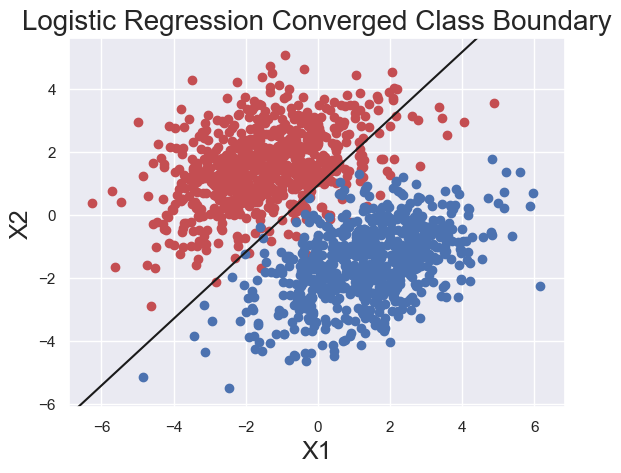

In [933]:
plot_dist(X_Train, Y_Train, th_conv, N, False)

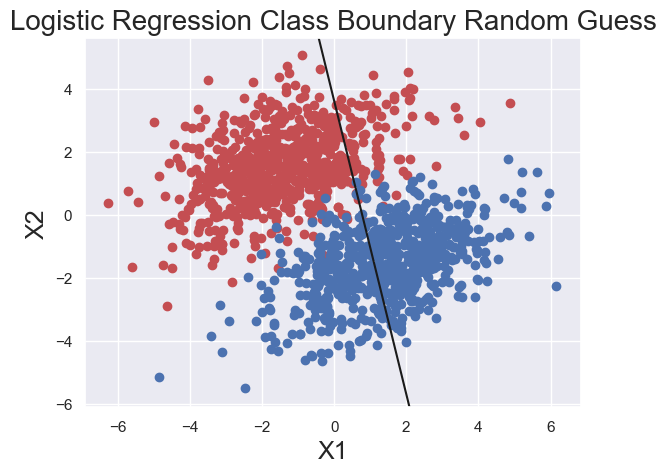

In [928]:
plot_dist(X_Train, Y_Train, th_conv, N, True)

In [858]:
animation = plot_dist_anim(X_Train, Y_Train, th_conv, N)
HTML(animation.to_jshtml())

Animation size has reached 21024343 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [929]:
y_pred = predict(X_Train, th_conv[:,N-1])
score = float(sum(y_pred == Y_Train))/ float(len(Y_Train))
print(score)

0.9785714285714285


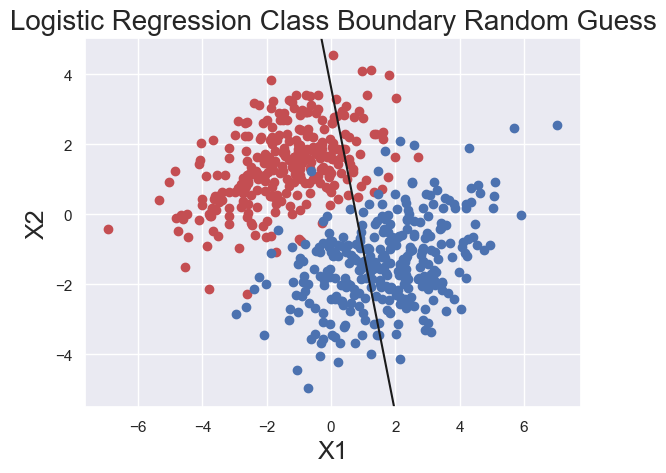

In [930]:
plot_dist(X_Test, Y_Test, th_conv, N, True)

In [931]:
y_pred = predict(X_Test, th_conv[:,N-1])
score = float(sum(y_pred == Y_Test))/ float(len(Y_Test))
print(score)

0.9716666666666667


## Online PCA

[Link](https://github.com/yuanx270/online-adaptive-PCA/blob/master/synthetic_experiment.ipynb)

[Dataset](https://www.kaggle.com/jsphyg/weather-dataset-rattle-package)

### Full Dataset

In [728]:
df = pd.read_csv('weatherAUS.csv', ',')
pd.options.display.max_columns = None
df.head()

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RISK_MM,RainTomorrow
0,2008-12-01,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,WNW,20.0,24.0,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,0.0,No
1,2008-12-02,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,WSW,4.0,22.0,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,0.0,No
2,2008-12-03,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,WSW,19.0,26.0,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,0.0,No
3,2008-12-04,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,E,11.0,9.0,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,1.0,No
4,2008-12-05,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,NW,7.0,20.0,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,0.2,No


In [729]:
percent_missing = df.isnull().sum() * 100 / len(df)
missing_values = pd.DataFrame({'percent_missing': percent_missing})
missing_values.sort_values(by ='percent_missing' , ascending=False)

,percent_missing
Sunshine,47.692924
Evaporation,42.789026
Cloud3pm,40.152469
Cloud9am,37.735332
Pressure9am,9.855619
Pressure3pm,9.832411
WindDir9am,7.041838
WindGustDir,6.561504
WindGustSpeed,6.519308
WindDir3pm,2.656952


In [730]:
df['RainTomorrow'].value_counts()

No     110316
Yes     31877
Name: RainTomorrow, dtype: int64

In [731]:
df['bias'] = np.ones((len(X_new), 1))

In [732]:
X = df[['RISK_MM', 'Location', 'bias']] #.drop(['RainTomorrow'], axis = 1)
Y = df['RainTomorrow']

In [733]:
X = pd.get_dummies(X, prefix_sep='_')
Y = LabelEncoder().fit_transform(Y)

In [734]:
X2 = StandardScaler().fit_transform(X)

X_Train, X_Test, Y_Train, Y_Test = train_test_split(X2, Y, test_size = 0.30, random_state = 101)

#### Kalman Filter

Estimated:  [17.109593231458444, -1.7086667042743355, 0.03264707338729959, 0.183346694809624, 0.040075323336505764, -0.2511749478638712, -0.07918676001982049, 0.21695608654356605, -0.045145239579791316, 0.037481833148631905, 0.2957449556449466, 0.10507903138991255, -0.07644786856960246, 0.09679427688674117, 0.162670211320052, -0.20844372439240605, -0.016022851386972337, 0.13052221450753776, -0.3744046247651072, 0.10224925978517384, 0.14748033196392427, 0.14884116056338995, -0.011899706147474987, -0.13725841267713135, 0.20392476324421768, 0.12368133231765371, 0.03850772929896635, -0.26176502047796224, 0.07906685810468941, 0.18954783812680942, 0.2207759731737936, -0.14746199177966743, -0.03745680293185089, -0.01954935389719323, 0.008703450064207793, -0.06921984450960328, 0.03659577509159075, 0.06779805057159319, 0.10284717030225846, 0.07525094218878256, 0.055512695337164526, -0.13672196900387476, 0.012693625250198324, -0.35273892312940514, -0.20115351861795408, 0.061438062792470556, 0.06

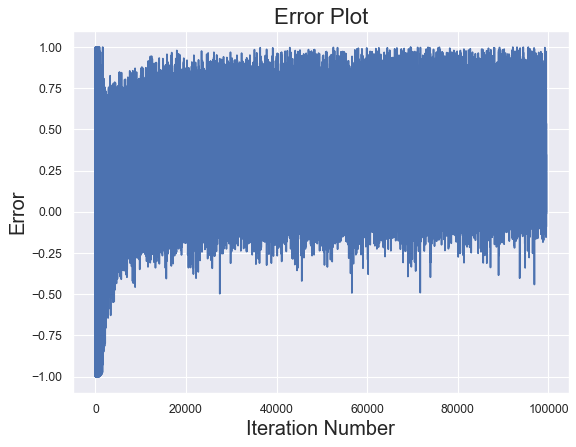

In [665]:
N = len(X_Train)
th_conv = extended_kalman(X_Train, Y_Train, N)

In [666]:
y_pred = predict(X_Test, th_conv[:,N-1])
score = float(sum(y_pred == Y_Test))/ float(len(Y_Test))
print(score)

0.9530685920577617


#### Sklearn

In [667]:
model = LogisticRegression()
model.fit(X_Train, Y_Train)
predicted_classes = model.predict(X_Test)
accuracy = accuracy_score(Y_Test.flatten(),predicted_classes)
print(accuracy)

0.9996014815509401


In [668]:
params = model.coef_
print(len(params[0]))

51


In [669]:
print(len(th_conv[:,N-1]))

51


### PCA Dataset 

In [670]:
pca = PCA(n_components=2)
X_new = pca.fit_transform(X2)
bias = np.ones((len(X_new), 1))
X_new = np.hstack((X_new,bias))

X_Train, X_Test, Y_Train, Y_Test = train_test_split(X_new, Y, test_size = 0.30, random_state = 101)

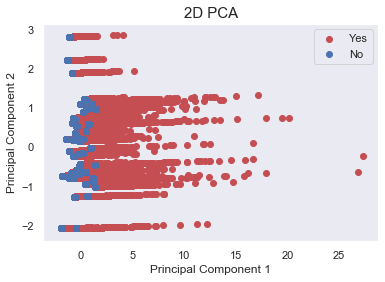

In [671]:
PCA_df = pd.DataFrame(data = X_new[:, 0:2], columns = ['PC1', 'PC2'])
PCA_df = pd.concat([PCA_df, df['RainTomorrow']], axis = 1)
PCA_df['RainTomorrow'] = LabelEncoder().fit_transform(PCA_df['RainTomorrow'])

classes = [1, 0]
colors = ['r', 'b']
for clas, color in zip(classes, colors):
    plt.scatter(PCA_df.loc[PCA_df['RainTomorrow'] == clas, 'PC1'], 
                PCA_df.loc[PCA_df['RainTomorrow'] == clas, 'PC2'], c = color)
    
plt.xlabel('Principal Component 1', fontsize = 12)
plt.ylabel('Principal Component 2', fontsize = 12)
plt.title('2D PCA', fontsize = 15)
plt.legend(['Yes', 'No'])
plt.grid()

#### Kalman Filter

Estimated:  [0.803502731847319, 0.23929495755360736, -1.2885584897353293]


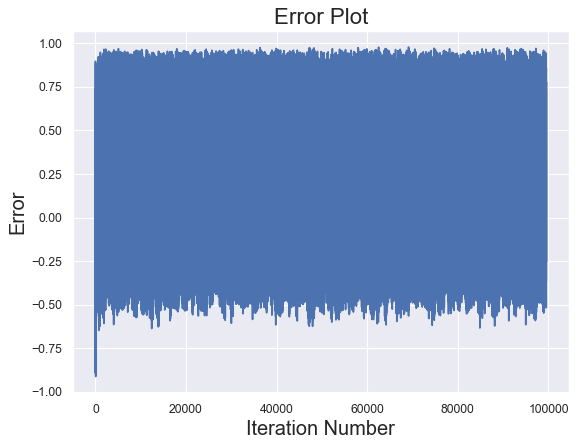

In [672]:
N = len(X_Train)
th_conv = extended_kalman(X_Train, Y_Train, N)

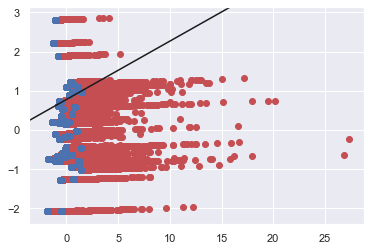

In [673]:
slope = -(th_conv[1,0] / th_conv[2,0])
intercept = -(th_conv[0,0] / th_conv[2,0])
classes = [1, 0]
colors = ['r', 'b']
for clas, color in zip(classes, colors):
    plt.scatter(PCA_df.loc[PCA_df['RainTomorrow'] == clas, 'PC1'], 
                PCA_df.loc[PCA_df['RainTomorrow'] == clas, 'PC2'], c = color)
ax = plt.gca()
ax.autoscale(False)
x_vals = np.array(ax.get_xlim())
y_vals = intercept + (slope * x_vals)
plt.plot(x_vals, y_vals, c="k");

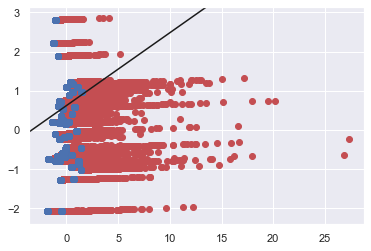

In [674]:
slope = -(th_conv[1,N-1] / th_conv[2,N-1])
intercept = -(th_conv[0,N-1] / th_conv[2, N-1])
classes = [1, 0]
colors = ['r', 'b']
for clas, color in zip(classes, colors):
    plt.scatter(PCA_df.loc[PCA_df['RainTomorrow'] == clas, 'PC1'], 
                PCA_df.loc[PCA_df['RainTomorrow'] == clas, 'PC2'], c = color)
ax = plt.gca()
ax.autoscale(False)
x_vals = np.array(ax.get_xlim())
y_vals = intercept + (slope * x_vals)
plt.plot(x_vals, y_vals, c="k");

In [675]:
y_pred = predict(X_Test, th_conv[:,N-1])
score = float(sum(y_pred == Y_Test))/ float(len(Y_Test))
print(score)

0.799803085001641


#### Sklearn

In [676]:
model = LogisticRegression()
model.fit(X_Train, Y_Train)
predicted_classes = model.predict(X_Test)
accuracy = accuracy_score(Y_Test.flatten(),predicted_classes)
print(accuracy)

0.8163533217684842


In [17]:
import fd_sketch
# https://github.com/hido/frequent-direction
def online_pca(X, k, e):
    U = np.zeros([len(X[0]), int(k//(e**3))])
    Z = np.zeros([len(X[0]), int(k//(e**2))])
    w = 0
    w_u = np.zeros(int(k//(e**3)))
    for t in range(len(X)):
        w = w + X[t]**2
        r = X[t] - U @ U.T @ X[t]
        p = (np.eye(len(X[0])) - U @ U.T)
        C = p @ Z @ Z.T @ p
        while (((C + r @ r.T) @ (C + r @ r.T).T).any() > (max(0, w.all()) * k/(e**2))):
            eigenValues, eigenVectors = linalg.eig(C)
            idx = eigenValues.argsort()[::-1]   
            eigenValues = eigenValues[idx]
            eigenVectors = eigenVectors[:,idx]
            w_u[[int(i) for i in eigenVectors[0]]] = eigenValues[0]
            flag = False
            for i in range(U.shape[1]):
                if U[: , i].all() == 0:
                    U[: , i] = eigenVectors[0]
                    flag = True
                    break
            if flag == True:
                # TODO Otherwise, write u
                # instead of the column v of U 
                # with the minimal quantity of (w_u)v
                pass
            p = (np.eye(len(X[0])) - U @ U.T)
            C = p @ Z @ Z.T @ p
            r = X[t] - U @ U.T @ X[t]
        #TODO Sketch
        fd_sketch.sketch(r, Z)
        for i in range(U.shape[1]):
            if U[: , i].any() != 0:
                w_u[i] = w_u[i] + np.inner(X[t], i)**2
        yield U.T @ X[t]

In [18]:
th = np.random.randn(55,10)

In [19]:
t = online_pca(th, k=5, e=0.056)

In [21]:
# for i in t:
#     print(i)